---
title: "Image Reconstruction using Matrix Factorization"
author: "Devansh Lodha"
date: "2024-12-28"
description: "This post will explore image reconstruction using matrix factorization with Spongebob!"
categories: [code, image processing]
image: "images/krustykrab.png"
jupyter: python3
format: html
---

general discussion on matrix factorization lorem ipsum dolor sit amet

We begin by setting up imports.

In [1]:
import torch
import torchvision
from torch import nn
from torchmetrics.functional.image import peak_signal_noise_ratio
from torchmetrics.functional.regression import mean_squared_error
device = torch.device('mps' if torch.backends.mps.is_available() else 'cpu')

import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

from sklearn.kernel_approximation import RBFSampler

## Setting up our image

Let's say we have a complete input image for testing purposes. We will first mask it by putting in `nan` values randomly. We'll use the masked image to reconstruct the original image using matrix factorization.

Since our image will be in RGB, we'll perform all operations for the three channels seperately.

In [2]:
# function to mask the image
def mask_image(img,
               prop,
               device):
    img_copy = img.clone().to(device)
    mask = torch.rand(img.shape[1:]) < prop # uniform distribution
    img_copy[0][mask] = float('nan')
    img_copy[1][mask] = float('nan')
    img_copy[2][mask] = float('nan')
    return img_copy, mask

# function that randomly removes 900 pixels from the image
def random_mask_image(img, device):
    img_copy = img.clone().to(device)
    h, w = img.shape[1], img.shape[2]
    total_pixels = h * w
    
    # Randomly select 900 pixel indices
    random_indices = torch.randperm(total_pixels)[:900]
    
    # Convert flat indices back to 2D indices (for height and width)
    mask = torch.zeros(h, w, dtype=torch.bool, device=device)
    mask.view(-1)[random_indices] = True
    
    # Apply NaN mask to each channel
    img_copy[0][mask] = float('nan')
    img_copy[1][mask] = float('nan')
    img_copy[2][mask] = float('nan')
    
    return img_copy, mask

## Implementing Matrix Factorization

To factorize any matrix $A$, we essentially want to _learn_ two matrices $W$ and $H$ such that $$A=W\cdot H$$
We want that $$W, H = argmin_{W',H'}  ||A-W'\cdot H'||_F^2$$
This can achieved using two methods: gradient descent and alternating least squares.

Let us first implement the `factorize(A, k, device)` function using gradient descent. This function will take as input the matrix to be factorized $A_{m \times n}$, the rank $k$ of decomposition and the device for pytorch code.

We first randomly initialize $W_{m\times k}$ and $H_{k\times n}$. Then for each iteration of gradient descent we follow the following update rules:
$$W = W - \alpha \frac{\partial ||A-W\cdot H||_F^2}{\partial W}$$
$$H = H - \alpha \frac{\partial ||A-W\cdot H||_F^2}{\partial H}$$

We use the `torch.optim.Adam` optimizer with a learning rate of `0.01`.

Since the input matrix can have certain pixels as `nan` we use a `mask` that ensures we only calculate loss by taking the norm of the non-nan values.

In [3]:
def factorize(A,
              k,
              device):
    """Factorize the matrix A into W and H"""
    A = A.to(device)
    # Randomly initialize W, H
    W = torch.randn(A.shape[0], k, requires_grad=True, device=device)
    H = torch.randn(k, A.shape[1], requires_grad=True, device=device)
    # Optimizer
    optimizer = torch.optim.Adam([W, H], lr=0.01)
    mask = ~torch.isnan(A)
    # Train the model
    for i in range(1000):
        # Compute the loss
        diff_matrix = torch.mm(W, H) - A
        diff_vector = diff_matrix[mask] # makes a 1D tensor
        loss = torch.norm(diff_vector)
        
        # Zero the gradients
        optimizer.zero_grad()
        
        # Backpropagate
        loss.backward()
        
        # Update the parameters
        optimizer.step()
        
    return W, H, loss

In [ ]:
def extract_not_nan_coordinates_pixels(image, device): 
  channels, height, width = image.shape
  coords = []
  pixel_values = [] 

  for y in range(height):
    for x in range(width):
      if image[0][x][y].isnan():
        continue
      coords.append([x, y])
      pixel_values.append(image[:, x, y].tolist())

  coords = torch.tensor(coords, dtype=torch.float32)
  pixel_values = torch.tensor(pixel_values, dtype=torch.float32)

  return coords.to(device), pixel_values.to(device)

def create_linear_model(input_dim, output_dim, device):
  return nn.Linear(input_dim, output_dim).to(device)

def train(coords, pixels, model, learning_rate=0.01, epochs=1000, threshold=1e-6, verbose=True):

    criterion = nn.MSELoss() # define the loss function (mse)
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate) # use the adam optimizer with the specified learning rate
    previous_loss = float('inf') # initialize w very large value (for early stopping)

    # training loops
    for epoch in range(epochs):
        optimizer.zero_grad() # reset the gradient of the optimizer
        outputs = model(coords) # compute the output
        loss = criterion(outputs, pixels) # calculate the loss that we defined earlier
        loss.backward() # compute teh gradients of the loss with respect to the parameters
        optimizer.step() # update the parameters based on the gradients computed above

        # check for early stopping
        if abs(previous_loss - loss.item()) < threshold:
            print(f"Stopping early at epoch {epoch} with loss: {loss.item():.6f}")
            break

        previous_loss = loss.item() # update the previous loss

        if verbose and epoch % 100 == 0:
            print(f"Epoch {epoch} loss: {loss.item():.6f}")

    return loss.item()

def create_rff_features(tensor, num_features, sigma, device):
    rff = RBFSampler(n_components=num_features, gamma=1/(2 * sigma**2), random_state=42)
    tensor = torch.tensor(rff.fit_transform(tensor.cpu().numpy())).float().to(device)
    return tensor

def create_coordinate_map(height, width, device, inv=False): # given the height and width of an image this function creates a coordinate map and returns it
  coords = []
  if not inv:
    for x in range(height):
      for y in range(width):
        coords.append([x, y])
  else:
     for y in range(height):
      for x in range(width):
        coords.append([x, y])

  return torch.tensor(coords, dtype=torch.float32).to(device)

## Defining metrics for the problem

We use `peak_signal_noise_ratio` and `mean_squared_error` from the `torchmetrics` library as metrics to evaluate the performance of our model. 
Peak Signal to Noise ratio:
Consider we have single channel of an image $A_{m \times n}$ and its learned factorization $A'=W_{m \times k}H_{k \times n}$,
MSE is defined as 
$$MSE = \frac{1}{mn}\sum_{i=0}^{m-1} \sum_{j=0}^{n-1} \left(A(i,j)-A'(i,j)\right)^2$$
The PSNR (in dB) is defined as 
$$PSNR = 10\log_{10}\left(\frac{MAX_A^2}{MSE}\right) = 20\log_{10}\left(MAX_A\right)-10\log_{10}\left(MSE\right)$$
Here $MAX_A$ is the maximum possible pixel value of the given channel $A$ of an iamge. For our case $MAX_A$ is simply 1. 

In [4]:
# function to compute the RMSE and PSNR
def metrics(img, reconstructed_img):
    rmse = mean_squared_error(target = img.reshape(-1),
                             preds=reconstructed_img.reshape(-1),
                             squared=False)
    psnr = peak_signal_noise_ratio(target=img.reshape(-1),
                                   preds=reconstructed_img.reshape(-1))
    return rmse, psnr

## Testing

We now write a function `plot_image_completion()` that takes as input: <br>
<li>`img`: the original image</li>
<li>`prop_list`: a list of proportions of pixels to mask</li>
<li>`factors_list`: a list of the decomposition factors</li>
<li>`device`: PyTorch device</li>

Now for each proportion of image to be masked `prop` in `prop_list`, we first mask the image, then for each `r` in `factors_list` we reconstruct all three channels and stack them to get a complete reconstructed image.

We also keep a track of RMSE and PSNR metrics for plotting later on.

In [11]:
def plot_image_completion(img,
                          prop_list,
                          factors_list,
                          device): 

    fig = plt.figure(figsize=(len(factors_list) * 4, len(prop_list) * 18))
    gs = GridSpec(3*len(prop_list)+1, len(factors_list), figure=fig)
    
    curr_row = 0
    for i, prop in enumerate(prop_list):
        masked_img, mask = mask_image(img=img,
                                  prop=prop,
                                  device=device)
        
        axorg = fig.add_subplot(gs[curr_row, 0:len(factors_list)//2])
        axmask = fig.add_subplot(gs[curr_row, len(factors_list)//2:])
        curr_row += 1

        axorg.imshow(img.permute(1,2,0).cpu().numpy())
        axorg.set_title(f"Original image")

        axmask.imshow(masked_img.permute(1,2,0).cpu().numpy())
        axmask.set_title(f"Masked image with prop={prop}")

        rmses = []
        psnrs = []
        for j, r in enumerate(factors_list):
            Wr, Hr, lossr = factorize(masked_img[0], r, device=device)
            Wg, Hg, lossg = factorize(masked_img[1], r, device=device)
            Wb, Hb, lossb = factorize(masked_img[2], r, device=device)
            reconstructed_img = torch.clamp(torch.stack([torch.mm(Wr, Hr).detach(), torch.mm(Wg, Hg).detach(), torch.mm(Wb, Hb).detach()], dim=0), 0, 1)

            rmse, psnr = metrics(img, reconstructed_img)
        
            rmses.append(rmse.cpu().numpy())
            psnrs.append(psnr.cpu().numpy())

            # Plot reconstructed image with metrics in the loop
            ax = fig.add_subplot(gs[curr_row, j])
            ax.imshow(reconstructed_img.permute(1,2,0).cpu().numpy())
            ax.set_title(f"prop= {prop}, r={r}, RMSE={rmse:.4f}, PSNR={psnr:.4f}")
            
        curr_row += 1
        # Plot RMSE and PSNR vs r outside the loop
        axrmse = fig.add_subplot(gs[curr_row,0:len(factors_list)//2])
        axrmse.plot(factors_list, rmses, marker='o')
        axrmse.set_xlabel('r')
        axrmse.set_ylabel('RMSE')
        axrmse.set_title('RMSE vs r')

        axpsnr = fig.add_subplot(gs[curr_row,len(factors_list)//2:])
        axpsnr.plot(factors_list, psnrs, marker='o')
        axpsnr.set_xlabel('r')
        axpsnr.set_ylabel('PSNR')
        axpsnr.set_title('PSNR vs r')

        curr_row += 1

    # Make the layout tight for better appearance
    plt.tight_layout()
    plt.show()

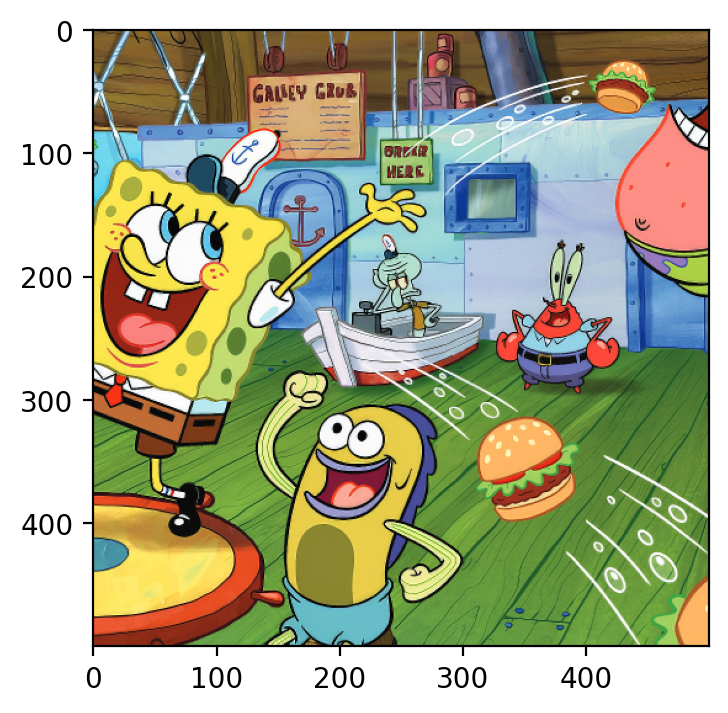

In [12]:
krustykrab = torchvision.io.read_image("images/krustykrab.png")
krustykrab = krustykrab.to(dtype=torch.float32, device=device)/255

transform = torchvision.transforms.CenterCrop((500, 500))

krustykrab = transform(krustykrab)

plt.figure(figsize=(6, 4))  
plt.imshow(krustykrab.permute(1,2,0).cpu().numpy())
plt.show()

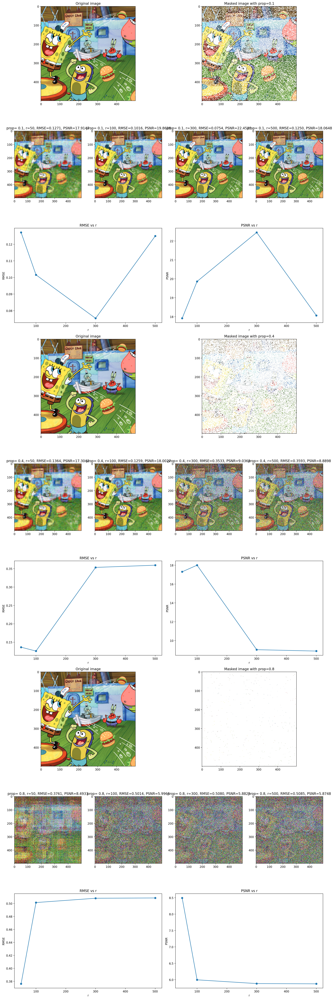

In [13]:
plot_image_completion(krustykrab, prop_list=[0.1, 0.4, 0.8], factors_list=[50,100,300,500], device=device)